In [26]:
import os
os.environ['KAGGLE_USERNAME'] = "piaiai" # username from the json file
os.environ['KAGGLE_KEY'] = "21eb7c81d4ca42fd1455d9714d485328" # key from the json file
!pip install -q kaggle
!kaggle competitions download -c 'data-science-bowl-2018'

stage1_train.zip: Skipping, found more recently modified local copy (use --force to force download)
stage1_test.zip: Skipping, found more recently modified local copy (use --force to force download)
stage1_train_labels.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
stage2_sample_submission_final.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
stage1_solution.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
stage1_sample_submission.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
stage2_test_final.zip: Skipping, found more recently modified local copy (use --force to force download)


In [27]:
import zipfile
os.makedirs('stage1_train', exist_ok=True)
os.makedirs('stage1_test', exist_ok=True)
with zipfile.ZipFile('/content/stage1_test.zip', 'r') as zip_ref:
    zip_ref.extractall("stage1_test")

with zipfile.ZipFile('/content/stage1_train.zip', 'r') as zip_ref:
    zip_ref.extractall('stage1_train')

In [35]:
from tqdm import tqdm
from skimage.io import imread
from skimage.transform import resize
from matplotlib import pyplot as plt
import seaborn as sns 
import numpy as np 
import pandas as pd

TRAIN_PATH = '/content/stage1_train/'

def extract_data(train_path, img_width=200, img_height=200, channels=3):
    train_ids = os.listdir(train_path)
    X_train = np.zeros((len(train_ids), img_height, img_width, channels), dtype=np.uint8)
    Y_train = np.zeros((len(train_ids), img_height, img_width, 1), dtype=np.bool)

    for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
        path = TRAIN_PATH + id_
        img = imread(path + '/images/' + id_ + '.png')[:,:,:channels]
        img = resize(img, (img_height, img_width), mode='constant', preserve_range=True)
        X_train[n] = img
        mask = np.zeros((img_height, img_width, 1), dtype=np.bool)
        for mask_file in next(os.walk(path + '/masks/'))[2]:
            mask_ = imread(path + '/masks/' + mask_file)
            mask_ = np.expand_dims(resize(mask_, (img_height, img_width), mode='constant', 
                                        preserve_range=True), axis=-1)
            mask = np.maximum(mask, mask_)
        Y_train[n] = mask

    return X_train, Y_train

X_train, Y_train = extract_data(TRAIN_PATH)

100%|██████████| 670/670 [06:42<00:00,  1.67it/s]


In [36]:
!pip install colorama
from colorama import Fore, Back, Style
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='whitegrid')
plt.style.use('fivethirtyeight')

print(Fore.BLUE + 'Number of training images:', Style.RESET_ALL, X_train.shape[0])

Number of training images:  670


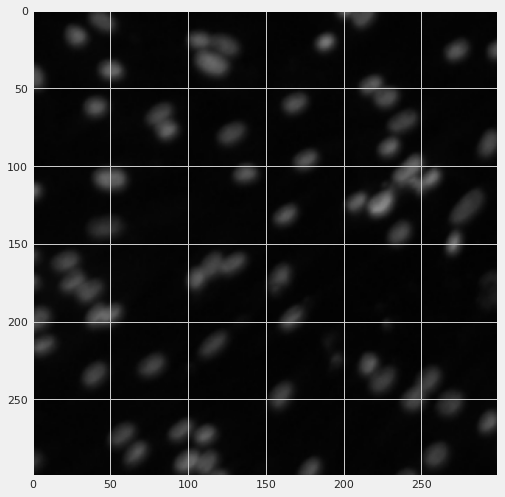

In [30]:
import random
plt.figure(figsize=(8,8))
plt.imshow(random.choice(X_train))

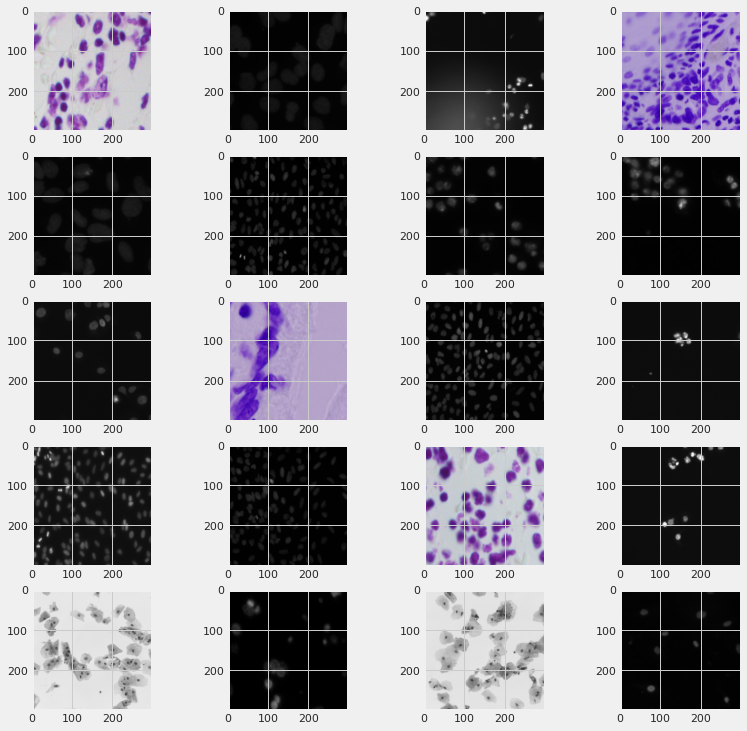

In [31]:
fig = plt.figure(figsize=(12,12))
cols = 4
rows = 5
for i in range(1, cols*rows + 1):
    fig.add_subplot(rows, cols, i)
    plt.imshow(random.choice(X_train))


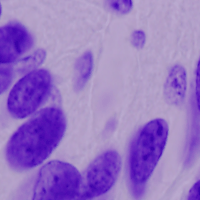

In [37]:
import imageio
from IPython.display import Image

imageio.mimsave("/tmp/gif.gif", X_train, duration=0.0001)
Image(filename="/tmp/gif.gif", format='png')

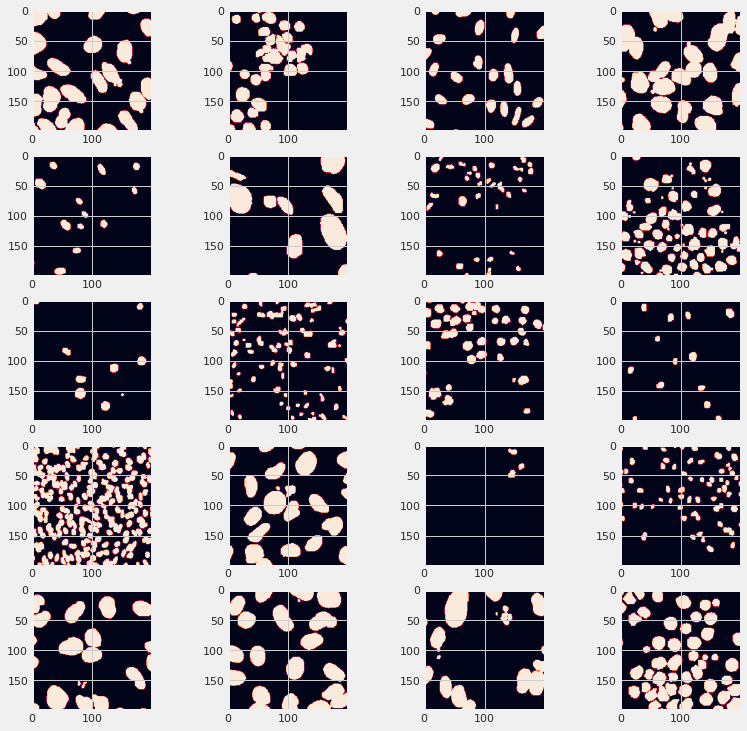

In [45]:
fig = plt.figure(figsize=(12,12))
cols = 4
rows = 5
for i in range(1, cols*rows + 1):
    fig.add_subplot(rows, cols, i)
    plt.imshow(random.choice(np.squeeze(Y_train, axis=3)))

In [43]:
Y_train.shape

(670, 200, 200, 1)